In [ ]:
import cv2
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import numpy as np
import torch

In [ ]:
!nvidia-smi

Mon May 29 13:32:33 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   67C    P8    11W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
if torch.cuda.is_available():
    print("The code will run on GPU.")
else:
    print("The code will run on CPU. Go to Edit->Notebook Settings and choose GPU as the hardware accelerator")
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

The code will run on GPU.


# SET DATA


In [ ]:
!mkdir /content/DATA
!mkdir /content/DATA/older_Data

In [ ]:
%cd /content/drive/MyDrive/Study/Domain_Adaptation_Vessel/older_vessel
!ls

/content/drive/MyDrive/Study/Domain_Adaptation_Vessel/older_vessel
repaired.zip  simulated_corrosion_multi_class_no_morph_1.json


In [ ]:
!unzip /content/drive/MyDrive/Study/Domain_Adaptation_Vessel/older_vessel/repaired.zip -d /content/DATA/older_Data
!cp /content/drive/MyDrive/Study/Domain_Adaptation_Vessel/older_vessel/simulated_corrosion_multi_class_no_morph_1.json /content/DATA/older_Data/images/

流式输出内容被截断，只能显示最后 5000 行内容。
  inflating: /content/DATA/older_Data/images/image_023000.png  
  inflating: /content/DATA/older_Data/images/image_023001.png  
  inflating: /content/DATA/older_Data/images/image_023002.png  
  inflating: /content/DATA/older_Data/images/image_023003.png  
  inflating: /content/DATA/older_Data/images/image_023004.png  
  inflating: /content/DATA/older_Data/images/image_023005.png  
  inflating: /content/DATA/older_Data/images/image_023006.png  
  inflating: /content/DATA/older_Data/images/image_023007.png  
  inflating: /content/DATA/older_Data/images/image_023008.png  
  inflating: /content/DATA/older_Data/images/image_023009.png  
  inflating: /content/DATA/older_Data/images/image_023010.png  
  inflating: /content/DATA/older_Data/images/image_023011.png  
  inflating: /content/DATA/older_Data/images/image_023012.png  
  inflating: /content/DATA/older_Data/images/image_023013.png  
  inflating: /content/DATA/older_Data/images/image_023014.png  
  inflating: 

In [ ]:
!mkdir /content/DATA/young_Data

!unzip /content/drive/MyDrive/Study/Domain_Adaptation_Vessel/young_vessel/Young_img.zip -d /content/DATA/young_Data
!cp /content/drive/MyDrive/Study/Domain_Adaptation_Vessel/young_vessel/simulated_corrosion_multi_class_1.json /content/DATA/young_Data/images/

流式输出内容被截断，只能显示最后 5000 行内容。
 extracting: /content/DATA/young_Data/images/image_002410.png  
 extracting: /content/DATA/young_Data/images/image_010240.png  
 extracting: /content/DATA/young_Data/images/image_004284.png  
 extracting: /content/DATA/young_Data/images/image_014345.png  
 extracting: /content/DATA/young_Data/images/image_008545.png  
 extracting: /content/DATA/young_Data/images/image_007532.png  
 extracting: /content/DATA/young_Data/images/image_007093.png  
 extracting: /content/DATA/young_Data/images/image_001268.png  
 extracting: /content/DATA/young_Data/images/image_000466.png  
 extracting: /content/DATA/young_Data/images/image_012298.png  
 extracting: /content/DATA/young_Data/images/image_013752.png  
 extracting: /content/DATA/young_Data/images/image_013645.png  
 extracting: /content/DATA/young_Data/images/image_015951.png  
 extracting: /content/DATA/young_Data/images/image_015163.png  
 extracting: /content/DATA/young_Data/images/image_002002.png  
 extracting: 

In [ ]:
!cp /content/drive/MyDrive/Study/Domain_Adaptation_Vessel/Script/annotation.py /content/DATA/young_Data/images/
!cp /content/drive/MyDrive/Study/Domain_Adaptation_Vessel/Script/annotation.py /content/DATA/older_Data/images/

##Method_1

In [ ]:
from pycocotools.coco import COCO
import os
import os.path as osp
import sys
import torch
import torch.utils.data as data
import torchvision.transforms as transforms
import cv2
import numpy as np
from pycocotools.coco import COCO
from google.colab.patches import cv2_imshow
from torch.utils.data import DataLoader

In [ ]:
class Transform(object):
    def __init__(self):
        self.label_map = COCO_LABEL_MAP

    def __call__(self, target, width, height):
        scale = np.array([width, height, width, height])
        res = []
        for obj in target:
            if 'bbox' in obj:
                bbox = obj['bbox']
                label_idx = self.label_map[obj['category_id']] - 1
                final_box = list(np.array([bbox[0], bbox[1], bbox[0]+bbox[2], bbox[1]+bbox[3]])/scale)
                final_box.append(label_idx)
                res += [final_box]  # [xmin, ymin, xmax, ymax, label_idx]
            else:
                print("No bbox found for object ", obj)

        return res  # [[xmin, ymin, xmax, ymax, label_idx], ... ]


class Data_Finder(data.Dataset):
    def __init__(self, image_path, info_file, transform=None,
                 target_transform=None, has_gt=True):
        self.root = image_path
        self.coco = COCO(info_file)
        self.ids = list(self.coco.imgToAnns.keys())

        if len(self.ids) == 0 or not has_gt:
            self.ids = list(self.coco.imgs.keys())
        self.transform = transform
        self.target_transform = target_transform

        self.has_gt = has_gt

    def __len__(self):
        return len(self.ids)

    def __getitem__(self, index):
        im, gt, Mask, h, w, num_crowds, name, Cat = self.pull_item(index)
        return im, (gt, Mask, num_crowds), name, Cat

    def pull_item(self, index):
        img_id = self.ids[index]
        if self.has_gt:
            ann_ids = self.coco.getAnnIds(imgIds=img_id)
            target = self.coco.loadAnns(ann_ids)
        else:
            target = []
        crowd = [x for x in target if ('iscrowd' in x and x['iscrowd'])] ## iscrowd=0: single target.   iscrowd=1: a group of target(overlapping)
        target = [x for x in target if not ('iscrowd' in x and x['iscrowd'])]
        num_crowds = len(crowd)

        # This is so we ensure that all crowd annotations are at the end of the array
        target += crowd
        file_name = self.coco.loadImgs(img_id)[0]['file_name']
        path = osp.join(self.root, file_name)
        img = cv2.imread(path)
        height, width, _ = img.shape

        if len(target) > 0:
            Cat = []
            Mask = self.coco.annToMask(target[0]).reshape(-1)
            for obj in target:
              mask = self.coco.annToMask(obj).reshape(-1)
              cat = obj['category_id']

              if cat not in Cat:
                Cat.append(cat)
                Mask = np.vstack((Mask, mask))
              else:
                Mask[-1] = Mask[-1] + mask

            Mask = Mask.reshape(-1, height, width)
            Mask = Mask[1:]
        if self.target_transform is not None and len(target) > 0:
            target = self.target_transform(target, width, height)
        return torch.from_numpy(img).permute(2, 0, 1), target, Mask, height, width, num_crowds, file_name, Cat

older data

In [ ]:
!mkdir /content/DATA/older_Data/labeled_data

img_path_older = '/content/DATA/older_Data/images'
annotation_path = '/content/drive/MyDrive/Study/Domain_Adaptation_Vessel/older_vessel/simulated_corrosion_multi_class_no_morph_1.json'


if __name__=='__main__':
    dataset = Data_Finder(img_path_older, annotation_path)
    Info = DataLoader(dataset)
    count = 0
    for img, label, name, Cat in Info:
        img = np.uint8(img.squeeze().numpy().transpose(1, 2, 0)) #rgb bgr
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        Name = name[0].replace('image', 'label')
        gt, masks, num_crowds = label
        masks = masks.squeeze(0) ## .squeeze(A): Delete A_th dimension. Now we left batch * H * w, each batch represent a category labeled by 'pixel==1'
        label_img = np.zeros_like(gray)
        Cat_np = []
        for i in Cat:
          Cat_np.append(i.numpy().reshape(-1))
        for m in range(masks.size(0)):
          mask = masks[m].numpy()
          label_img[np.where(mask==1)] = Cat_np[m][0]
        cv2.imwrite(osp.join('/content/DATA/older_Data/labeled_data', Name), label_img)

loading annotations into memory...
Done (t=5.11s)
creating index...
index created!


In [ ]:
import os

def get_imlist(path, txt):
  data = open(txt, 'w+')
  for f in os.listdir(path):
    if f.endswith('.png'):
      print(f, file = data)
  data.close()


source_list = get_imlist('/content/DATA/older_Data/labeled_data', '/content/sourcelist.txt')

In [ ]:
olderlabel_img_path = '/content/DATA/older_Data/labeled_data'

young data

In [ ]:
!mkdir /content/DATA/young_Data/labeled_data

img_path_young = '/content/DATA/young_Data/images'
annotation_path = '/content/DATA/young_Data/images/simulated_corrosion_multi_class_1.json'

if __name__=='__main__':
  dataset = Data_Finder(img_path_young, annotation_path)
  Info = DataLoader(dataset)
  for img, label, name, Cat in Info:
        img = np.uint8(img.squeeze().numpy().transpose(1, 2, 0))
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        Name = name[0].replace('image', 'label')
        gt, masks, num_crowds = label
        masks = masks.squeeze(0)
        label_img = np.zeros_like(gray)
        Cat_np = []
        for i in Cat:
          Cat_np.append(i.numpy().reshape(-1))
        for m in range(masks.size(0)):
          mask = masks[m].numpy()
          label_img[np.where(mask==1)] = Cat_np[m][0]
        cv2.imwrite(osp.join('/content/DATA/young_Data/labeled_data', Name), label_img)

loading annotations into memory...
Done (t=1.28s)
creating index...
index created!


In [ ]:
#4 cat seam spot edge background

In [ ]:
import os

def get_imlist(path, txt):
  data = open(txt, 'w+')
  for f in os.listdir(path):
    if f.endswith('.png'):
      print(f, file = data)
  data.close()


target_list = get_imlist('/content/DATA/young_Data/labeled_data', '/content/targetlist.txt')

In [ ]:
younglabel_img_path = '/content/DATA/young_Data/labeled_data'

In [ ]:
from PIL import Image
img =  Image.open('/content/DATA/older_Data/images/image_013990.png')
label =  Image.open('/content/DATA/older_Data/labeled_data/label_013990.png')

print(img.size, label.size)

(672, 376) (672, 376)


#Training Model

In [ ]:
%load_ext tensorboard
#%reload_ext tensorboard
%tensorboard --logdir=runs

##Train

In [ ]:
%cd /content/drive/MyDrive/Study/Domain_Adaptation_Vessel/MSTN/mstn-master

/content/drive/MyDrive/Study/Domain_Adaptation_Vessel/MSTN/mstn-master


In [ ]:
!python3 train.py

Streaming output truncated to the last 5000 lines.
[it 5710][src seg loss 0.1823][domain loss -0.1167][loss_val 0.1386][classifier seg loss 0.1921]  
[it 5720][src seg loss 0.4841][domain loss -0.1101][loss_val 0.2453][classifier seg loss 0.4939]  
[it 5730][src seg loss 0.0945][domain loss -0.1079][loss_val 0.1970][classifier seg loss 0.1042]  
[it 5740][src seg loss 0.0918][domain loss -0.1081][loss_val 0.2342][classifier seg loss 0.1016]  
[it 5750][src seg loss 0.0966][domain loss -0.1226][loss_val 0.0745][classifier seg loss 0.1064]  
[it 5760][src seg loss 0.3898][domain loss -0.1093][loss_val 0.2296][classifier seg loss 0.3996]  
[it 5770][src seg loss 0.1343][domain loss -0.1081][loss_val 0.1552][classifier seg loss 0.1440]  
[it 5780][src seg loss 0.1600][domain loss -0.1115][loss_val 0.1390][classifier seg loss 0.1698]  
[it 5790][src seg loss 0.3699][domain loss -0.1133][loss_val 0.1722][classifier seg loss 0.3797]  
[it 5800][src seg loss 0.1523][domain loss -0.0745][loss_v

In [ ]:
%rm -r /content/drive/MyDrive/Study/Domain_Adaptation_Vessel/MSTN/mstn-master/checkpoint
%mkdir /content/drive/MyDrive/Study/Domain_Adaptation_Vessel/MSTN/mstn-master/checkpoint

In [ ]:
!python3 trainvessel.py

/usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
epoch: 10, lr: 0.009925650290240803, lambda: 4.999999999810711e-06
correct: 0.0, C_loss: 3.4341838359832764, G_loss:-0.1375577449798584, D_loss:0.1521420180797577, Gregloss: 0.09085246175527573, Dregloss: 0.014584279619157314, semantic_loss: 0.016688739880919456, F_loss: 3.5250356197357178
epoch: 20, lr: 0.009852577760521605, lambda: 9.999999999621423e-06
correct: 1.0, C_loss: 3.410930633544922, G_loss:-0.13968253135681152, D_loss:0.15426309406757355, Gregloss: 0.0908554419875145, Dregloss: 0.014580563642084599, semantic

# validation


In [ ]:
%cd /content/drive/MyDrive/Study/Domain_Adaptation_Vessel/Baseline_GR
%mkdir results

/content/drive/MyDrive/Study/Domain_Adaptation_Vessel/Baseline_GR


source

In [ ]:
%cd /content/drive/MyDrive/Study/Domain_Adaptation_Vessel/MSTN/mstn-master
!python3 test.py

In [ ]:
%cd /content/drive/MyDrive/Study/Domain_Adaptation_Vessel/Reverse/Reverse_DA

In [ ]:
!python3 Test.py

In [ ]:
%rm -r /content/drive/MyDrive/Study/Domain_Adaptation_Vessel/Baseline_GR/results

loading annotations into memory...
Done (t=0.79s)
creating index...
index created!
image_000010.png 



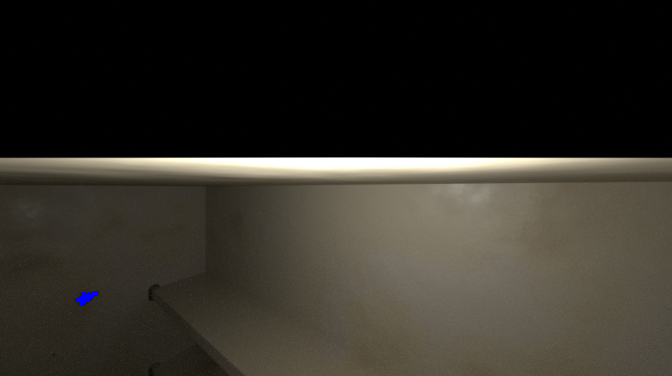

image_000005.png 



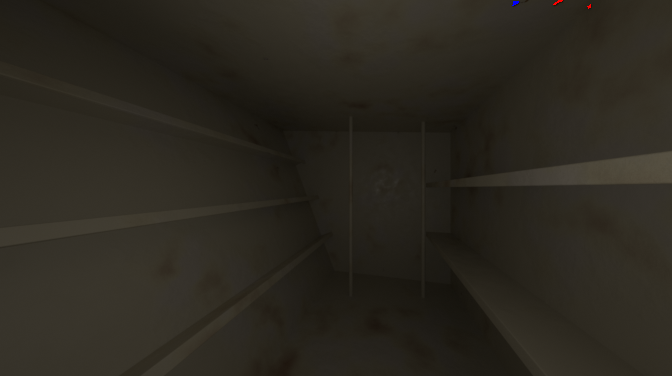

image_000006.png 



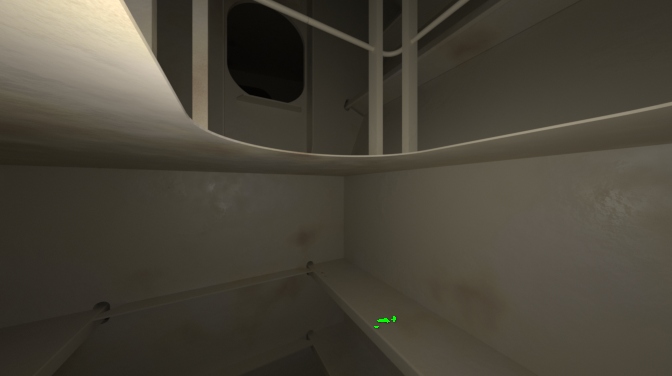

image_000007.png 



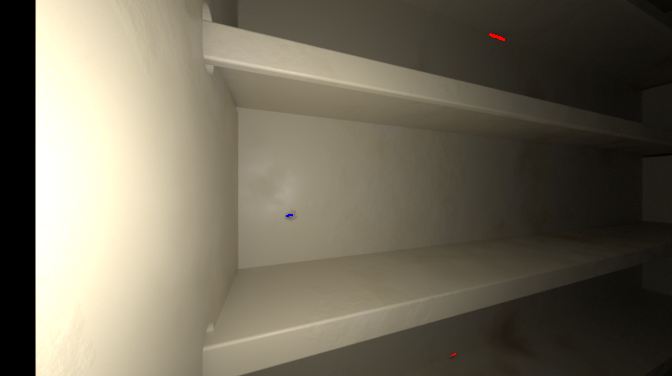

image_000008.png 



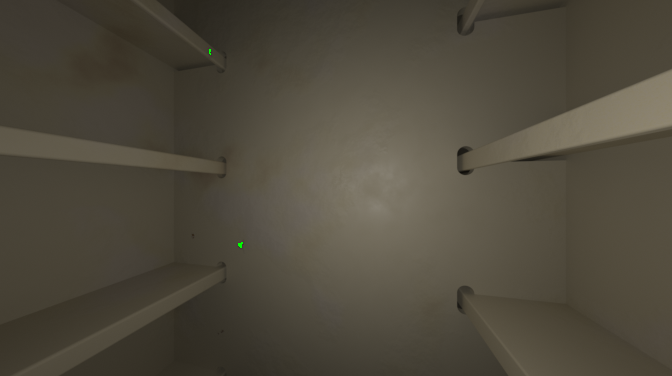

image_000000.png 



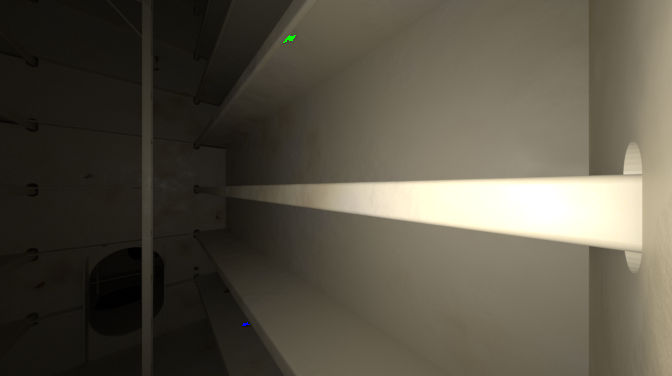

image_000003.png 



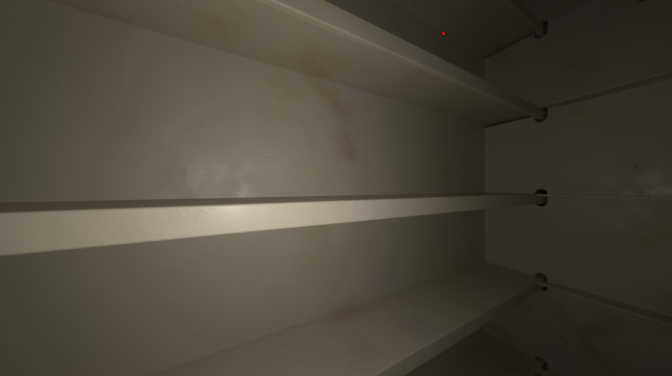

image_000009.png 



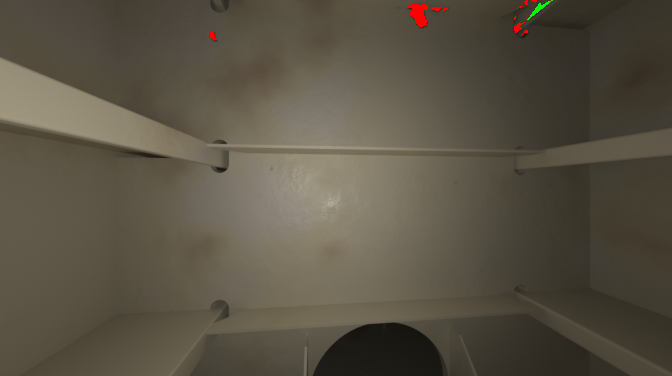

image_000001.png 



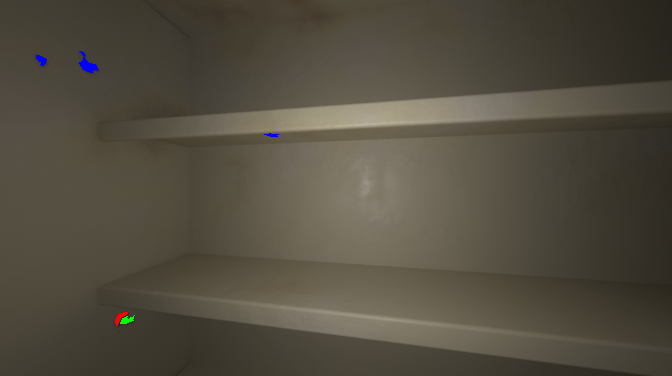

image_000011.png 



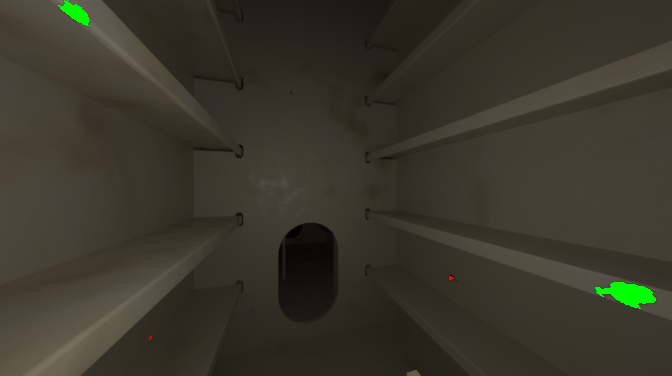

image_000013.png 



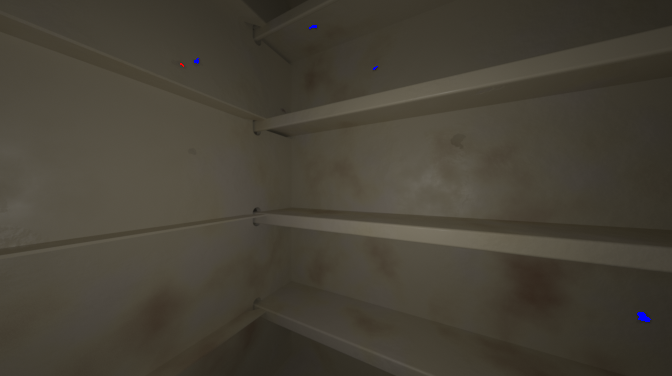

image_000019.png 



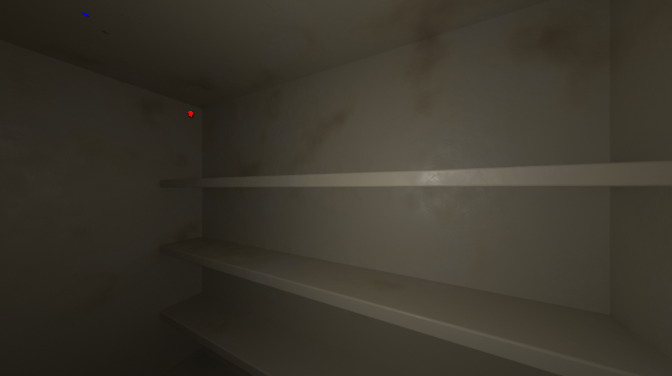

image_000015.png 



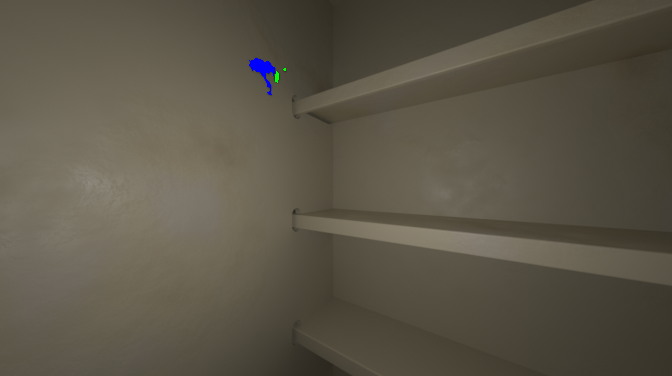

image_000016.png 



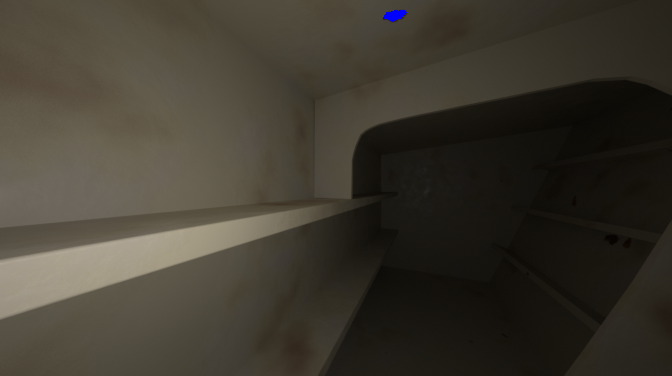

image_000012.png 



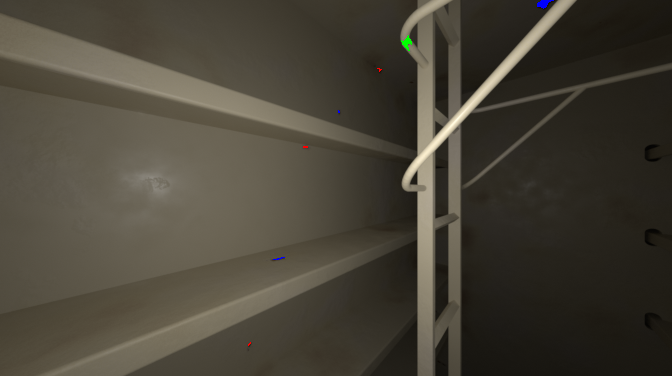

image_000018.png 



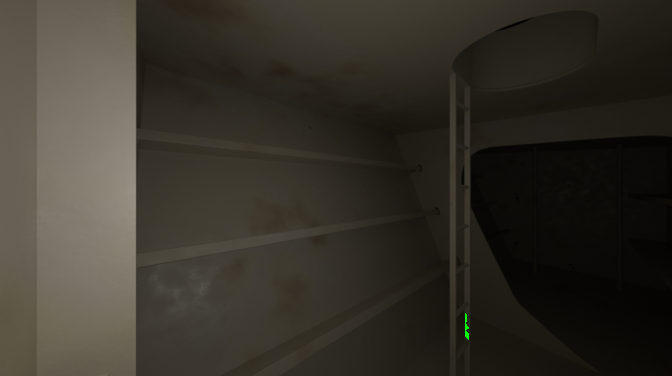

image_000017.png 



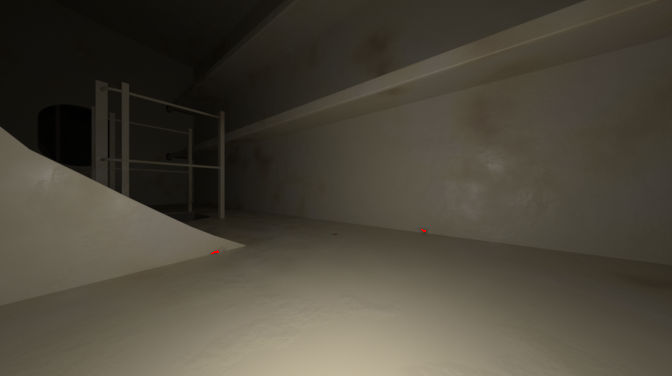

image_000014.png 



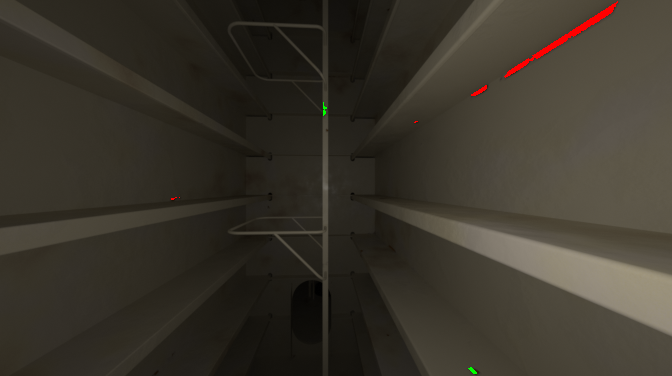

image_000021.png 



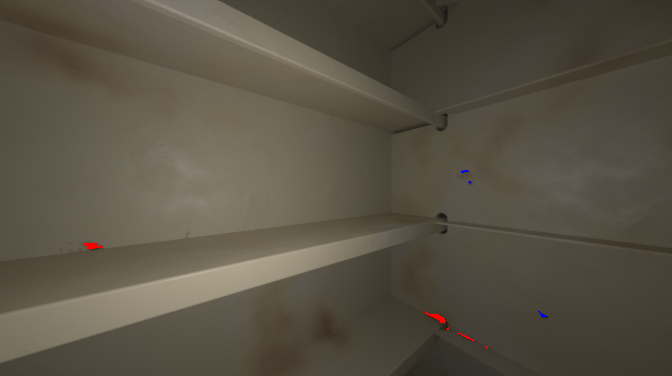

image_000020.png 



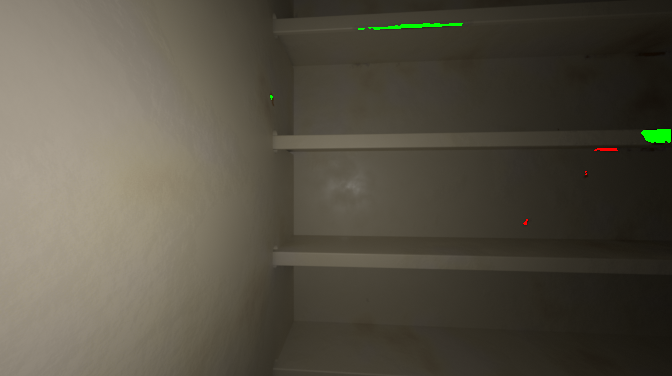

image_000022.png 



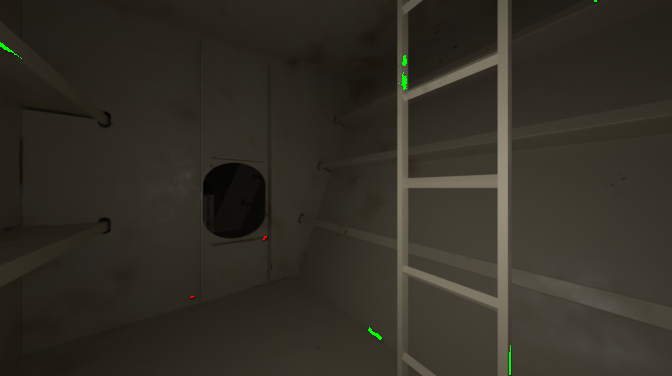

image_000023.png 



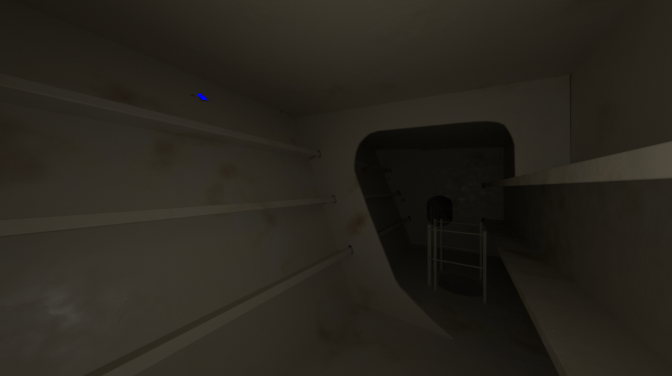

image_000024.png 



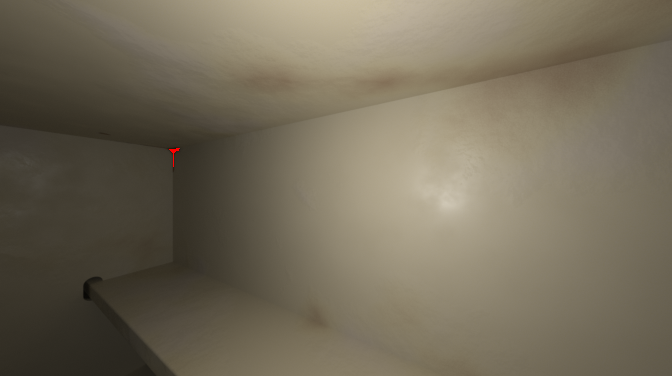

image_000028.png 



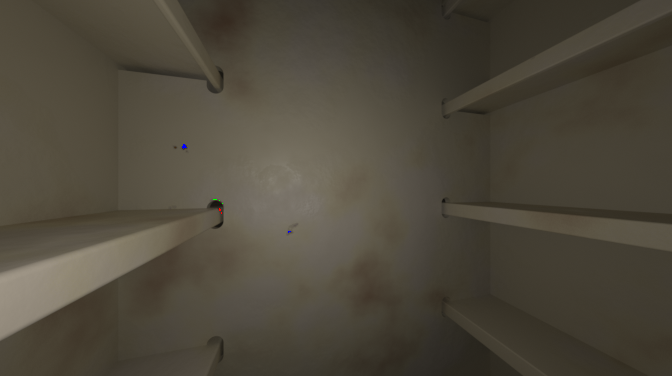

image_000025.png 



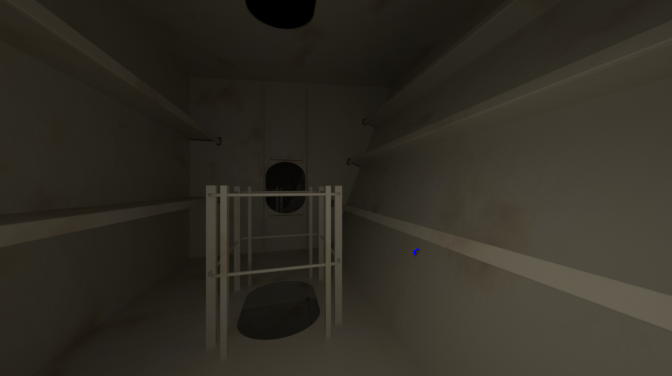

image_000027.png 



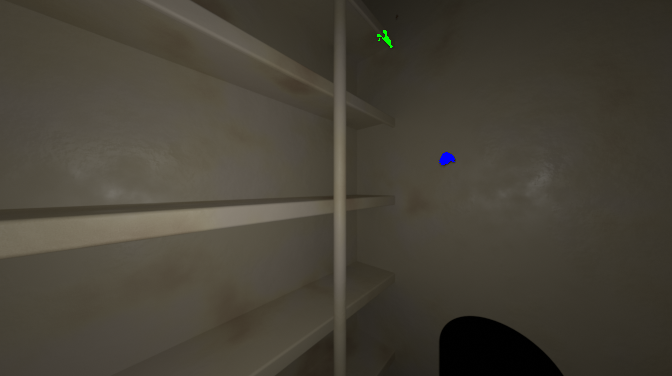

image_000030.png 



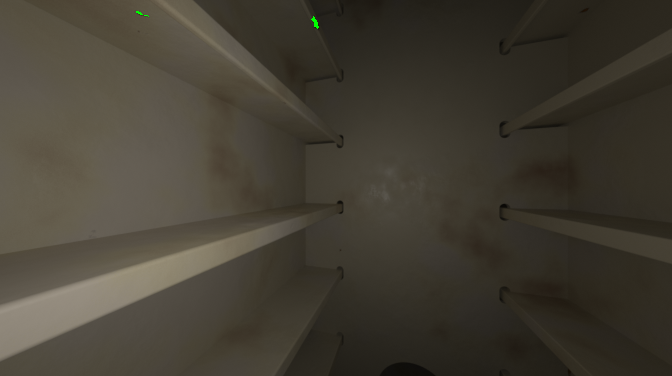

image_000029.png 



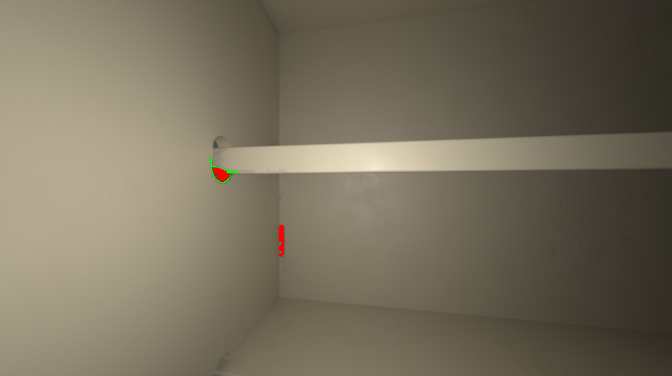

image_000032.png 



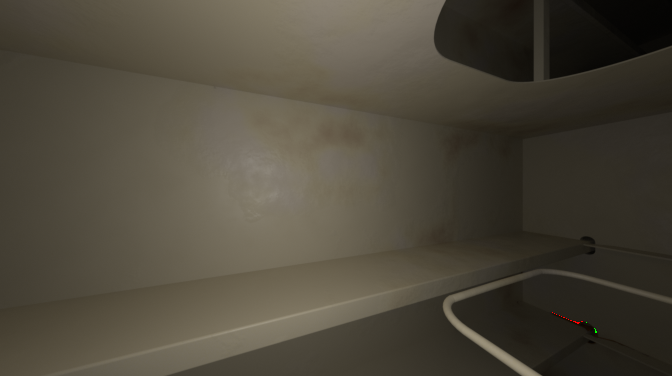

image_000033.png 



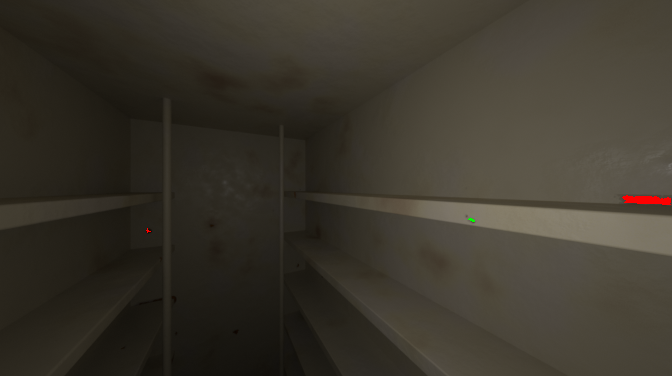

image_000036.png 



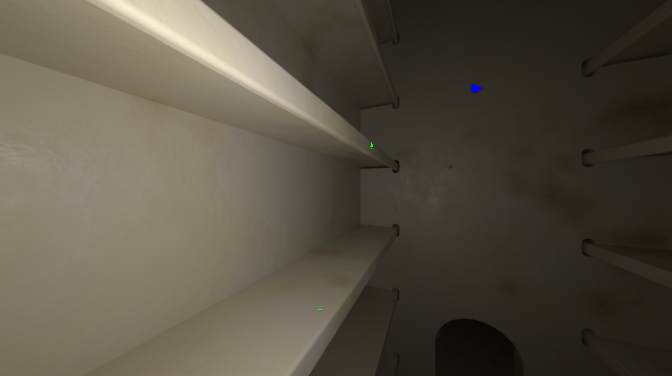

image_000035.png 



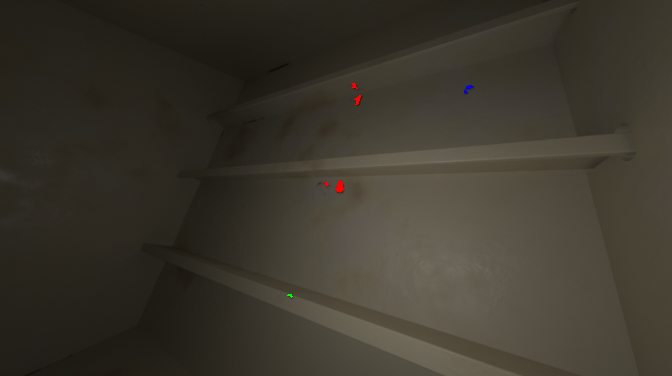

image_000037.png 



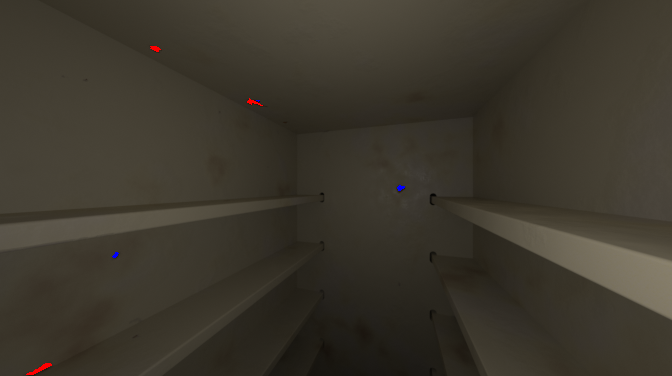

image_000039.png 



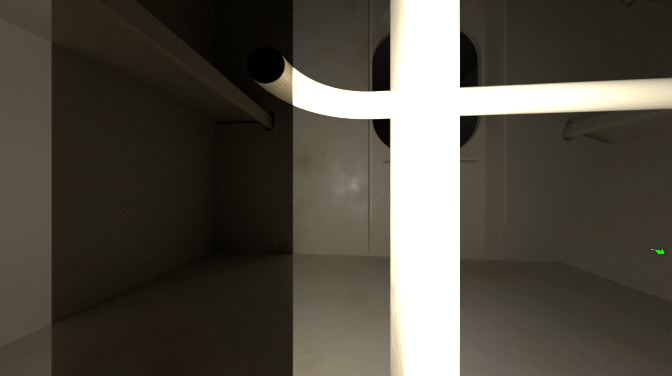

image_000040.png 



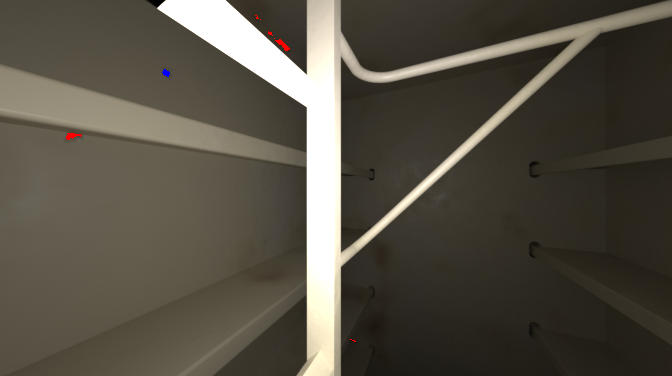

image_000042.png 



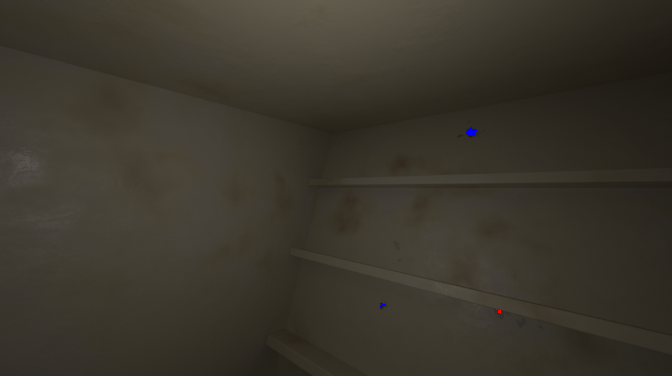

image_000038.png 



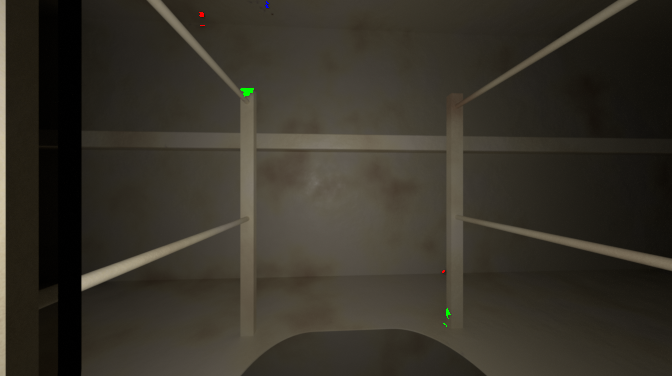

image_000034.png 



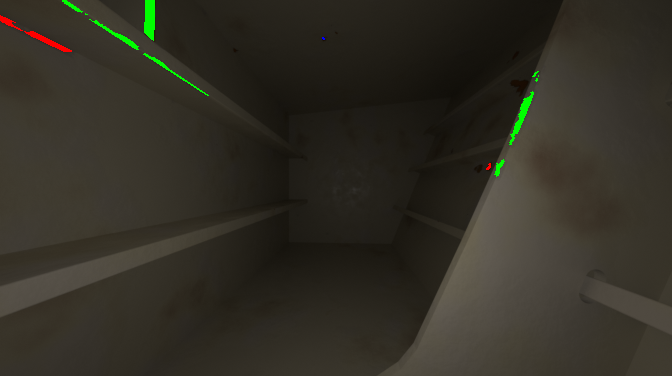

image_000041.png 



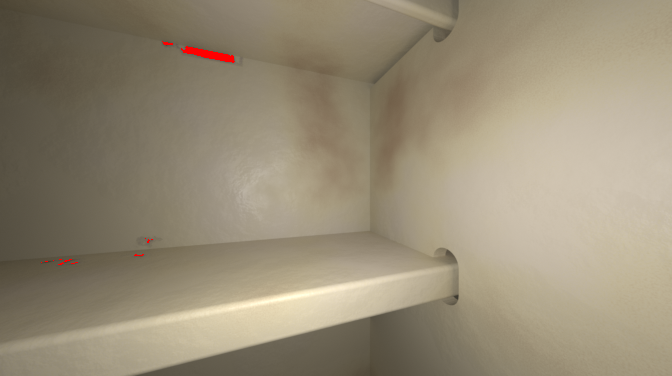

image_000031.png 



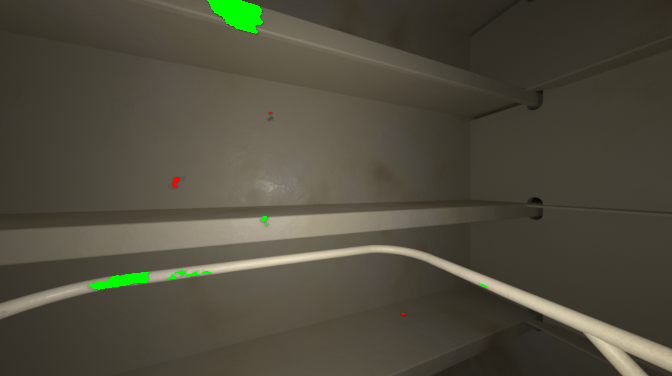

image_000043.png 



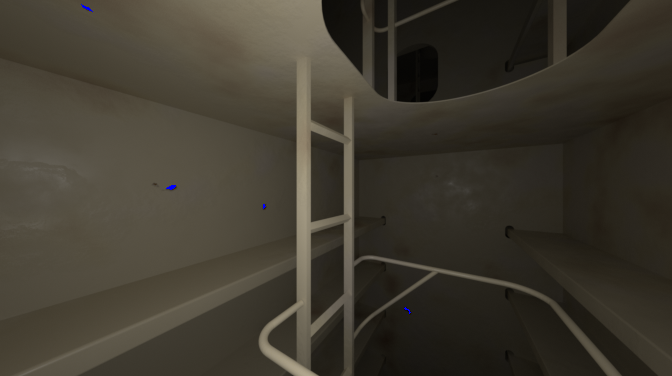

image_000044.png 



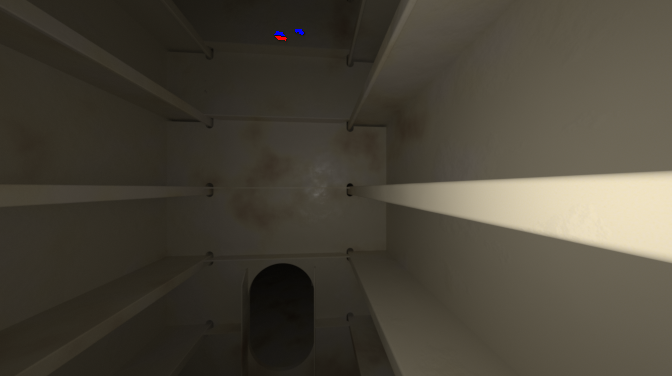

image_000045.png 



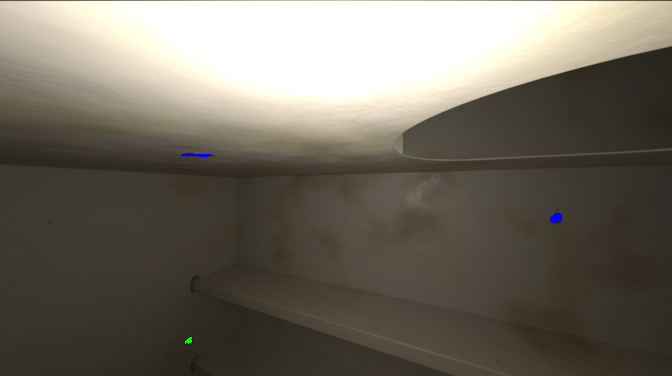

image_000046.png 



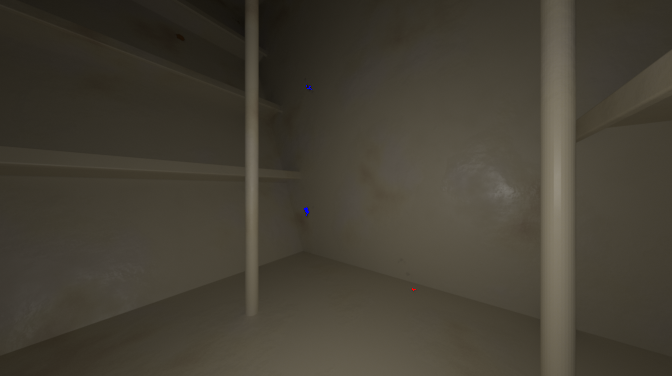

image_000051.png 



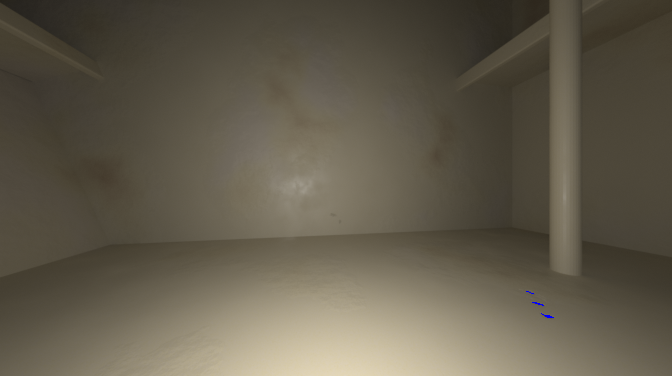

image_000049.png 



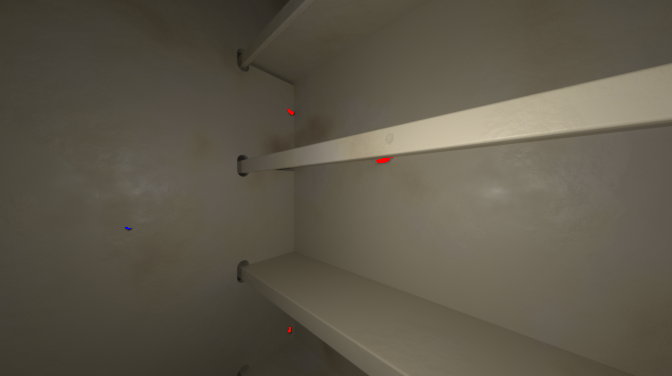

image_000048.png 



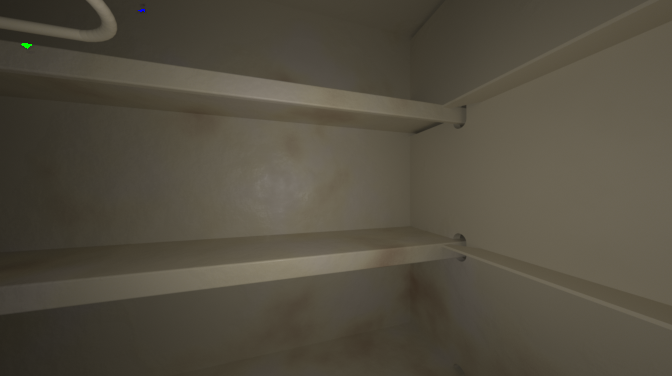

image_000050.png 



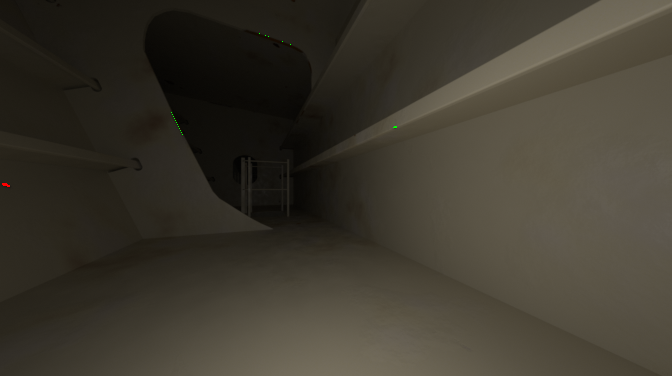

image_000052.png 



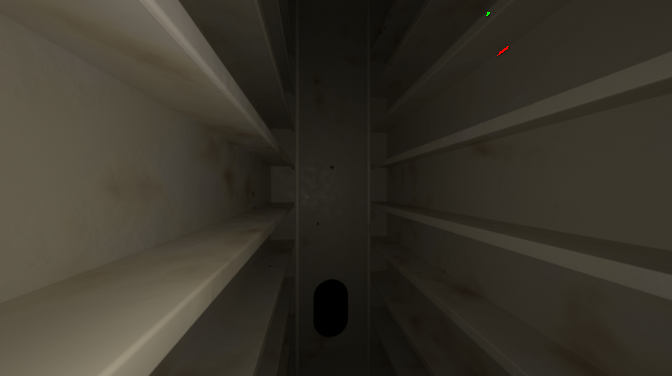

image_000053.png 



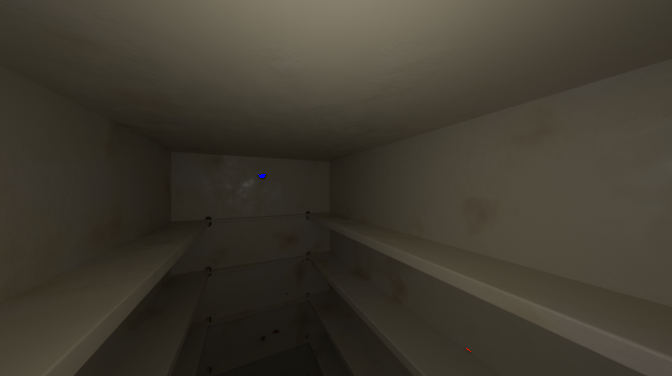

image_000056.png 



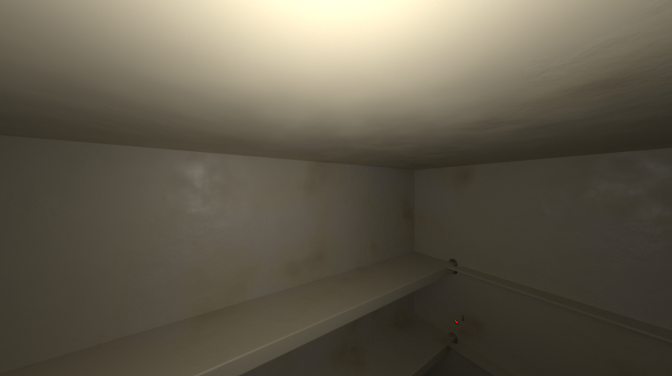

image_000055.png 



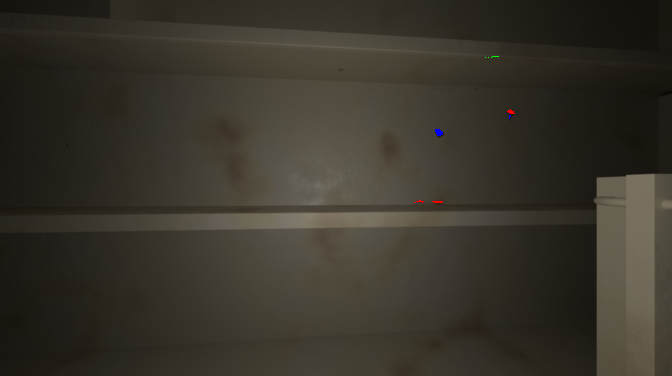

image_000054.png 



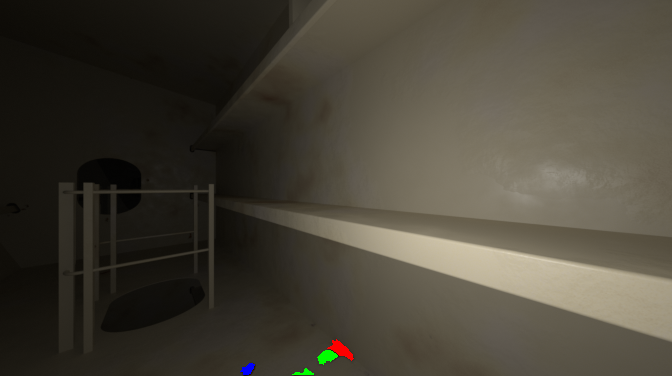

image_000057.png 



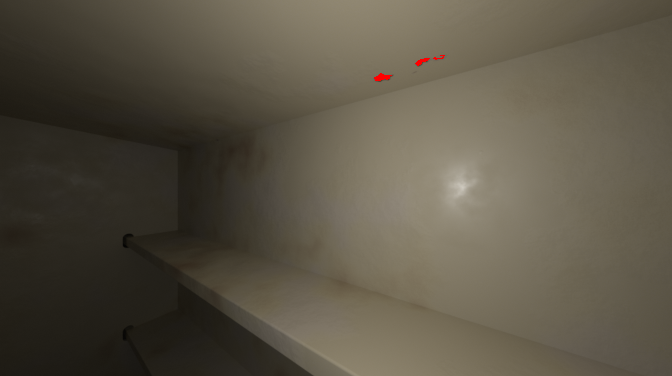

image_000047.png 



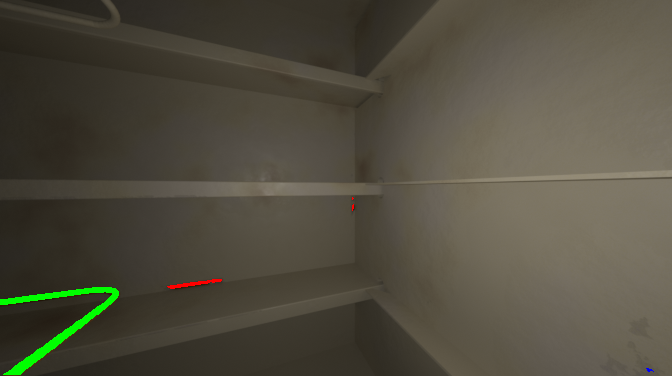

image_000058.png 



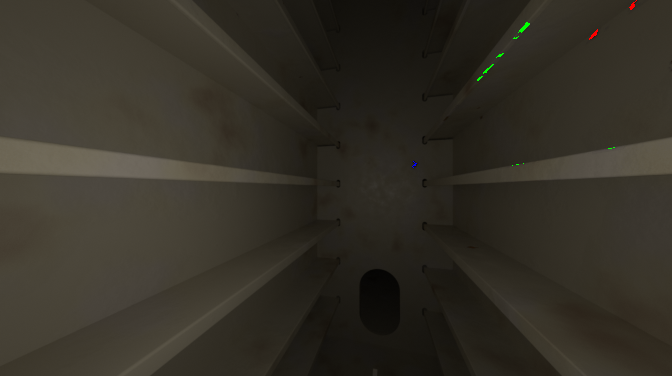

image_000061.png 



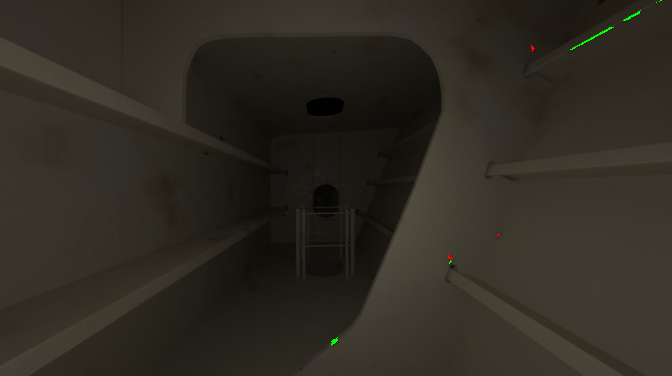

image_000062.png 



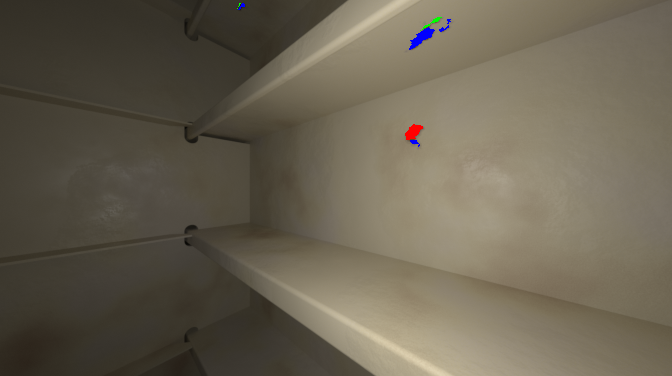

image_000065.png 



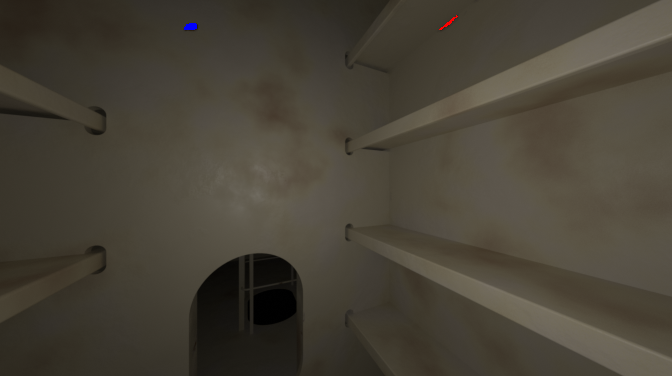

image_000059.png 



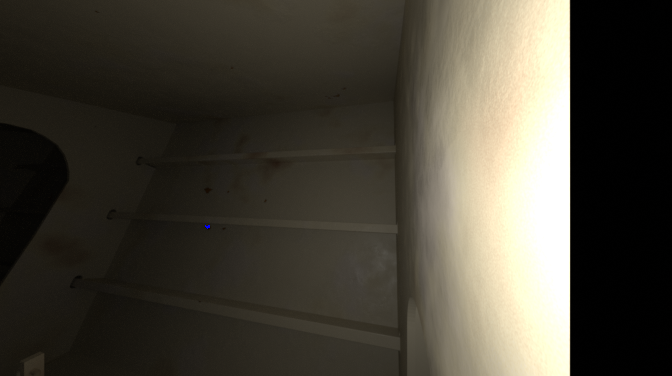

image_000066.png 



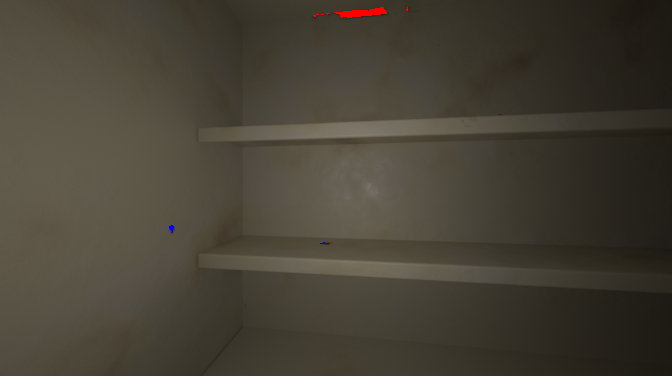

image_000064.png 



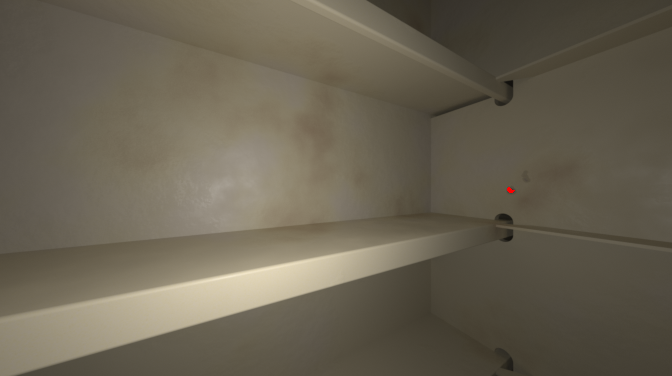

image_000067.png 



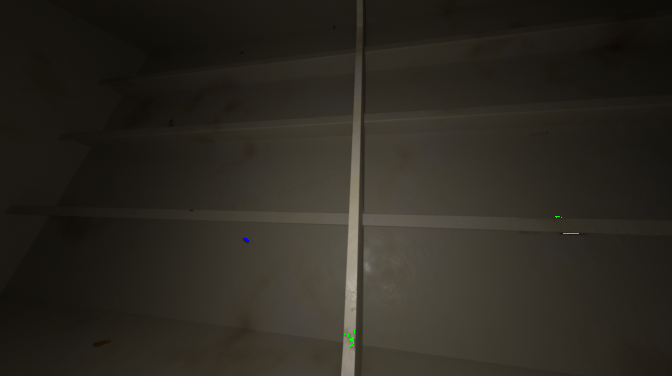

image_000063.png 



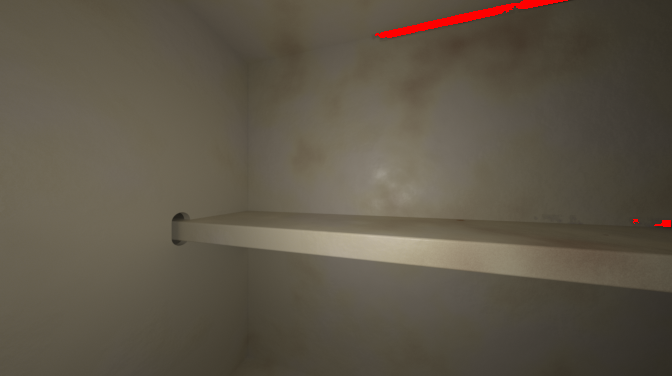

image_000068.png 



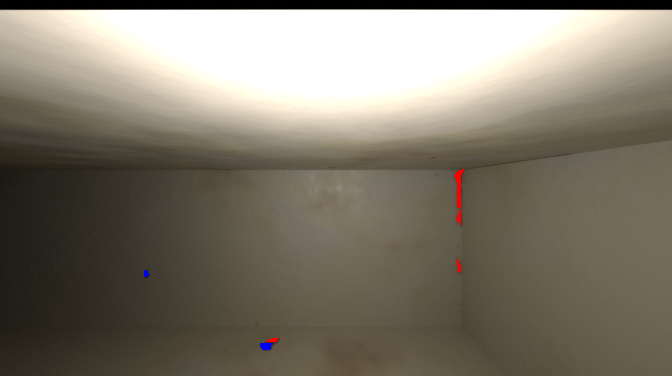

image_000060.png 



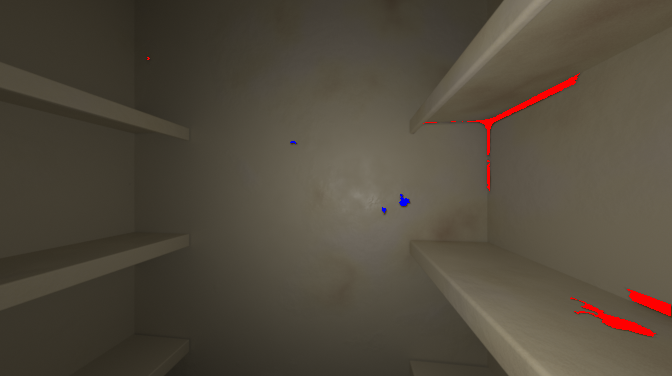

image_000070.png 



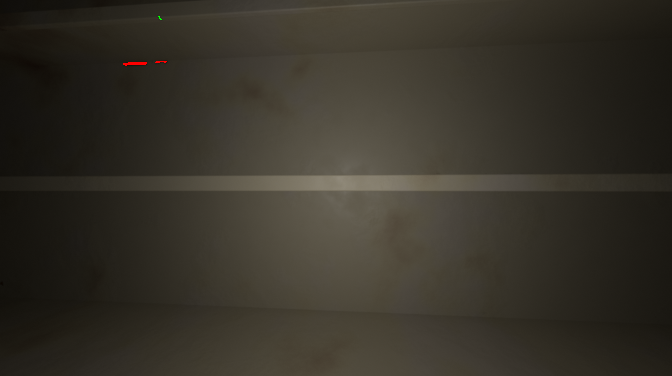

image_000069.png 



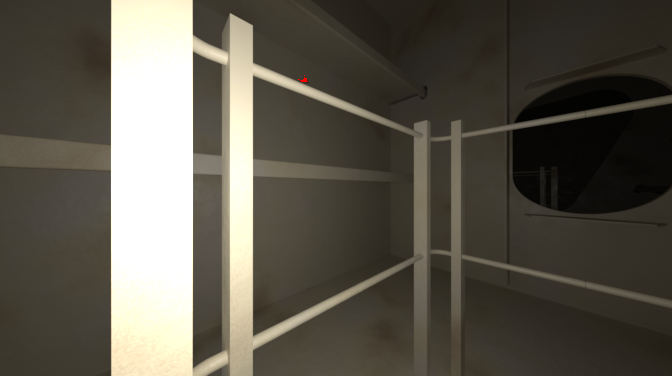

image_000072.png 



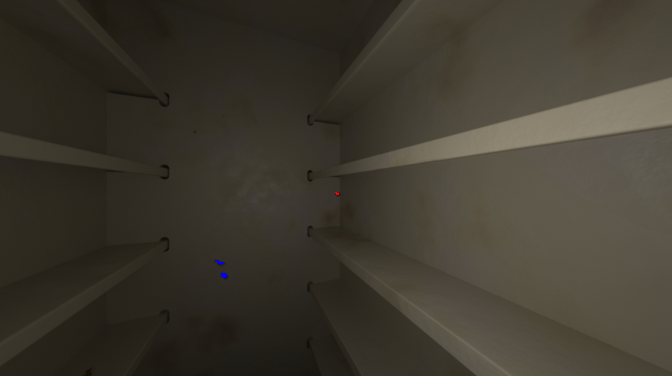

image_000075.png 



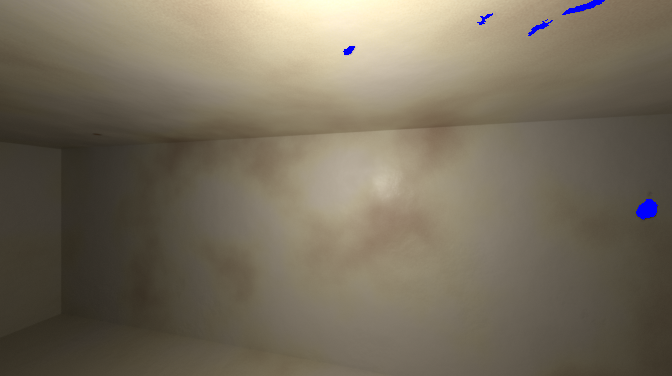

image_000073.png 



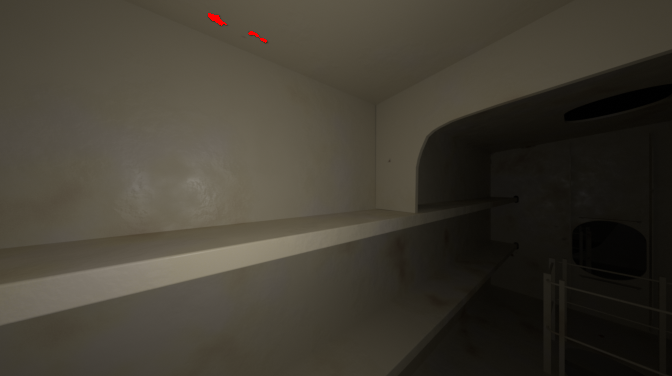

image_000076.png 



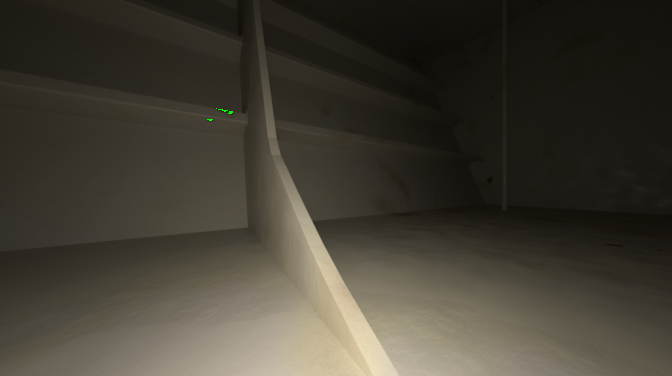

image_000077.png 



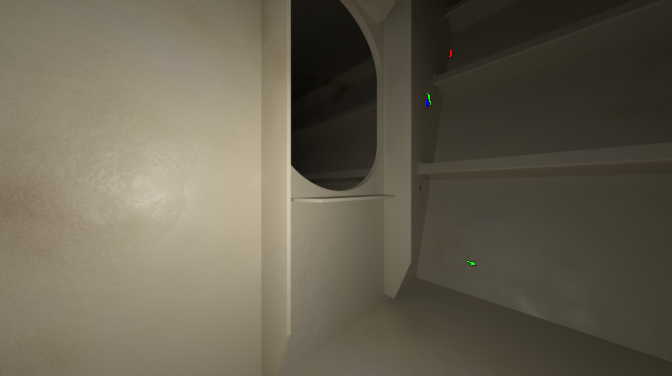

image_000078.png 



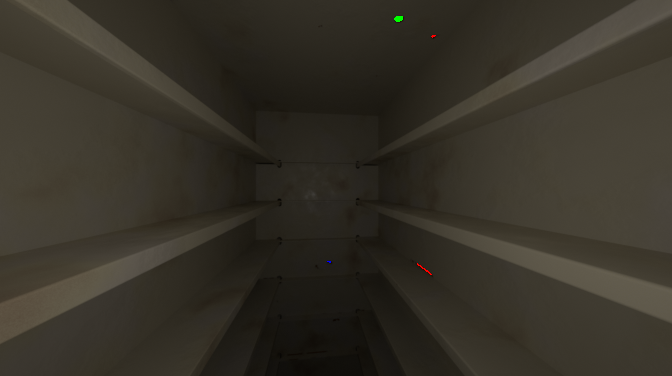

image_000074.png 



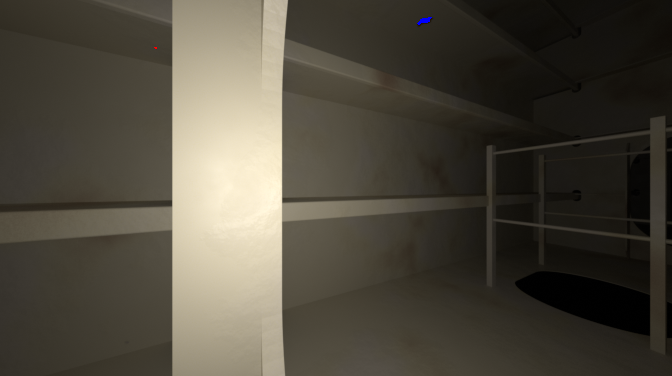

image_000079.png 



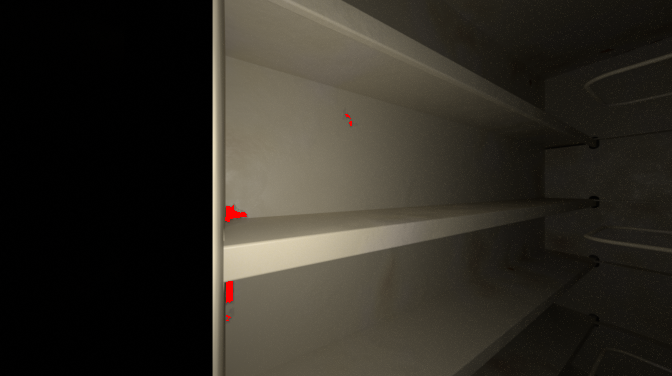

image_000081.png 



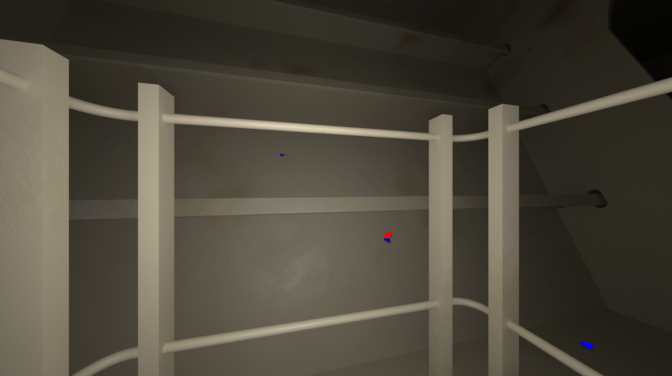

image_000082.png 



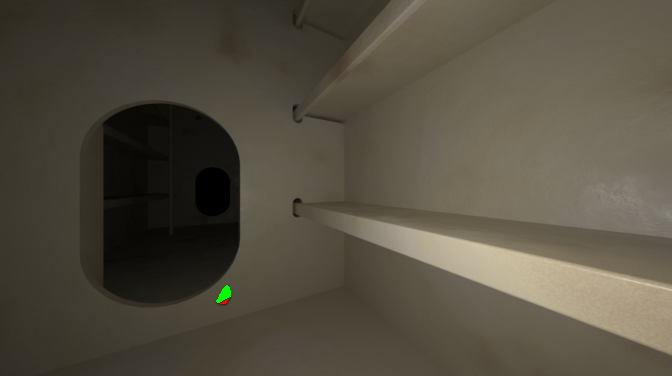

image_000089.png 



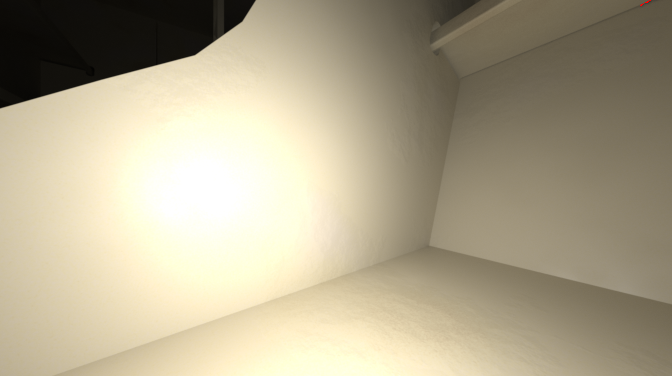

image_000085.png 



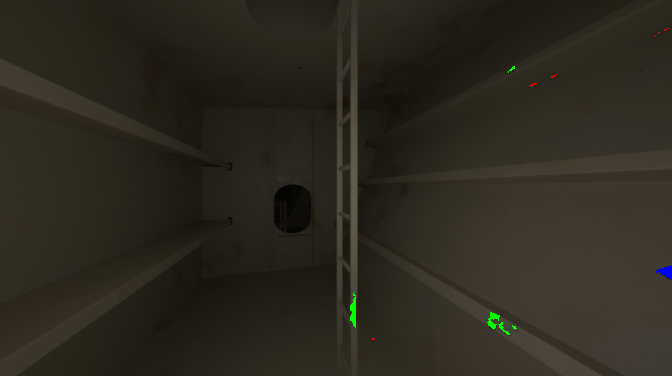

image_000080.png 



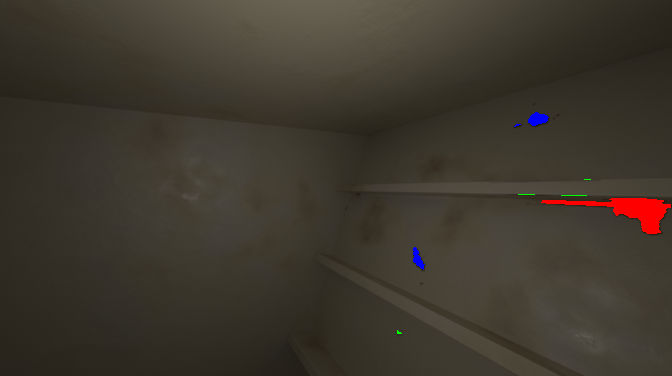

image_000086.png 



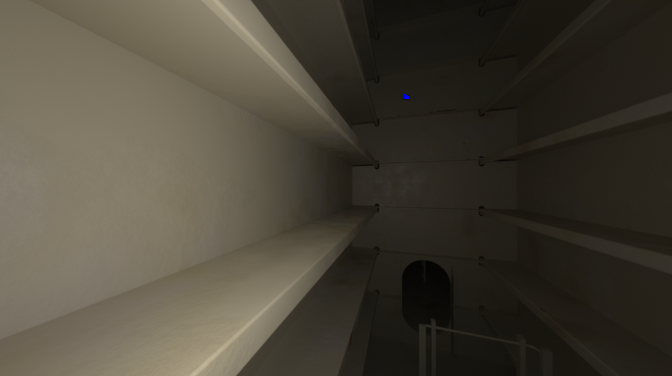

image_000083.png 



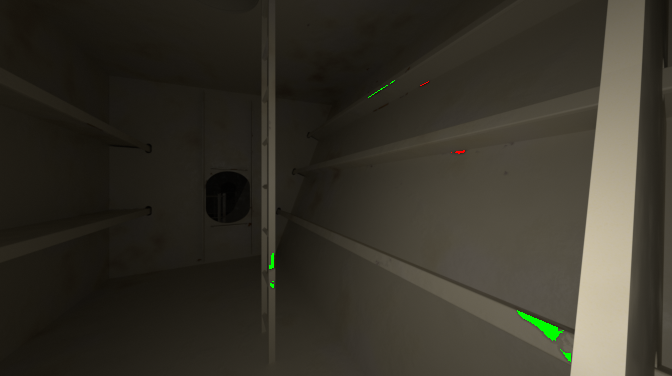

image_000090.png 



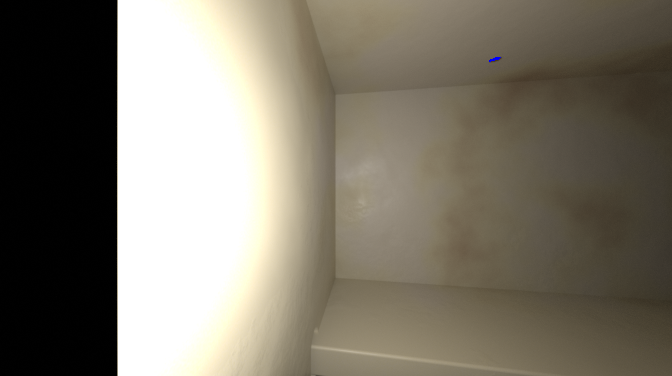

In [ ]:
## Show the labeled image extracted from json File
image = '/content/DATA/young_Data/images'
info_json =  '/content/DATA/young_Data/images/simulated_corrosion_multi_class_1.json'
#image = '/content/DATA/older_Data/images'
#info_json = '/content/drive/MyDrive/Study/Domain_Adaptation_Vessel/older_vessel/simulated_corrosion_multi_class_no_morph_1.json'

if __name__=='__main__':
    dataset = Data_Finder(image, info_json)
    loader = DataLoader(dataset)
    for img, label, name, Cat in loader:
        img = np.uint8(img.squeeze().numpy().transpose(1, 2, 0))
        print(name[0], '\n')
        #for i in Cat:
        #  print((i.numpy())[0])
        gt, masks, num_crowds = label
        masks = masks.squeeze(0)
        color = np.array([[0, 0, 255], [0, 255, 0], [255, 0, 0]])
        for m in range(masks.size(0)):
            mask = masks[m].numpy()
            y, x = np.where(mask == 1)
            img[y, x, :] = color[[Cat[m].numpy()][0] - 1]
        cv2_imshow(img)
